In [ ]:
# both non preprocessed and processed
#     each learning rate
#         each step size
#             loss curve
#             prediction
#             weights


In [ ]:
from detecto import core, utils, visualize
import os
import random 
import glob
import matplotlib.pyplot as plt
import cv2
from xml.dom import minidom#, parse
import numpy

from torchvision import transforms
from detecto.utils import normalize_transform

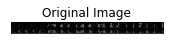

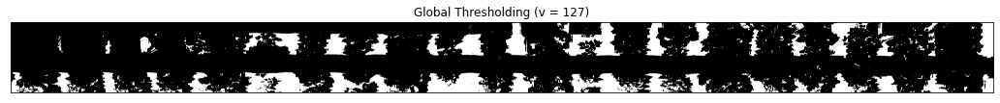

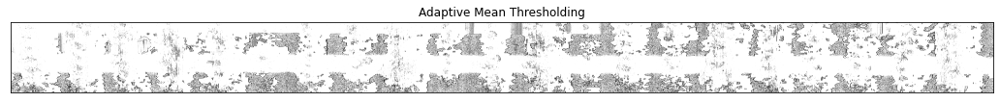

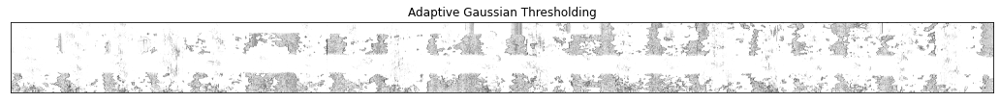

<Figure size 2880x2880 with 0 Axes>

In [3]:
# Adaptive Thresholding

import cv2 as cv
import numpy as np
from matplotlib import pyplot as plt
img = cv.imread('/home/travis_s/repos/infloresence_detection/selected_train_images/c75c2548-7ded-4799-bab0-bfb697bad4ff.png', 0)img = cv.imread('/home/travis_s/repos/infloresence_detection/selected_train_images/c75c2548-7ded-4799-bab0-bfb697bad4ff.png', 0)
# img = cv.medianBlur(img,5)
ret,th1 = cv.threshold(img,20,255,cv.THRESH_BINARY)
th2 = cv.adaptiveThreshold(img,255,cv.ADAPTIVE_THRESH_MEAN_C,\
            cv.THRESH_BINARY,11,2)
th3 = cv.adaptiveThreshold(img,255,cv.ADAPTIVE_THRESH_GAUSSIAN_C,\
            cv.THRESH_BINARY,11,2)
titles = ['Original Image', 'Global Thresholding (v = 127)',
            'Adaptive Mean Thresholding', 'Adaptive Gaussian Thresholding']
images = [img, th1, th2, th3]
for i in range(4):
    plt.subplot(2,2,i+1),plt.imshow(images[i],'gray')
    plt.title(titles[i])
    plt.xticks([]),plt.yticks([])
    plt.figure(figsize = (40,40))
plt.show()

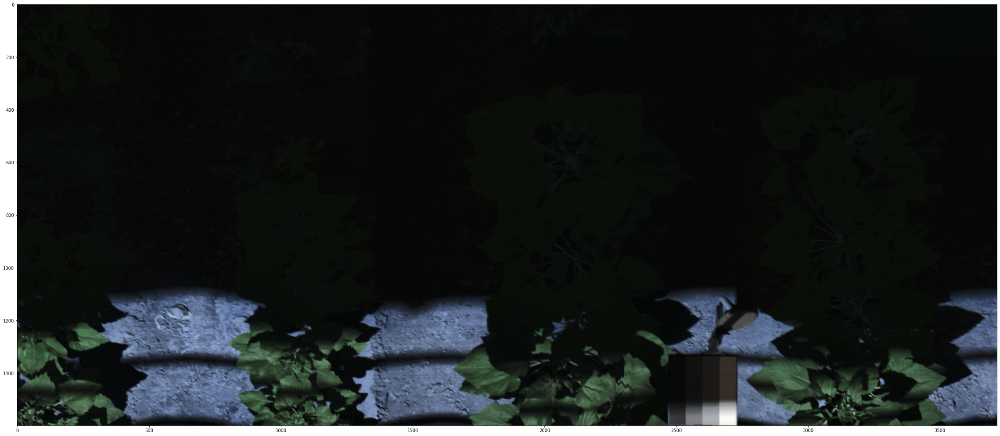

In [3]:
# Clahe

import cv2
import numpy as np
from matplotlib import pyplot as plt
import glob
import random

images = glob.glob('./selected_train_images/*.png')


# img = cv2.imread('/home/travis_s/repos/infloresence_detection/selected_train_images/c75c2548-7ded-4799-bab0-bfb697bad4ff.png', 1)

img = cv2.imread(random.choice(images))

#-----Reading the image-----------------------------------------------------
# img = cv2.imread('Dog.jpg', 1)
# cv2.imshow("img",img) 

#-----Converting image to LAB Color model----------------------------------- 
lab= cv2.cvtColor(img, cv2.COLOR_BGR2LAB)
# cv2.imshow("lab",lab)

#-----Splitting the LAB image to different channels-------------------------
l, a, b = cv2.split(lab)
# cv2.imshow('l_channel', l)
# cv2.imshow('a_channel', a)
# cv2.imshow('b_channel', b)

#-----Applying CLAHE to L-channel-------------------------------------------
clahe = cv2.createCLAHE(clipLimit=3.0, tileGridSize=(8,8))
cl = clahe.apply(l)
# cv2.imshow('CLAHE output', cl)

#-----Merge the CLAHE enhanced L-channel with the a and b channel-----------
limg = cv2.merge((cl,a,b))
# cv2.imshow('limg', limg)

#-----Converting image from LAB Color model to RGB model--------------------
img = cv2.cvtColor(limg, cv2.COLOR_LAB2BGR)
# cv2.imshow('final', final)

plt.figure(figsize = (40,40))
plt.imshow(img)
plt.show()

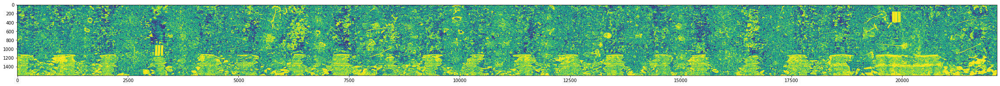

In [15]:

# hist equalization

import cv2
import numpy as np
from matplotlib import pyplot as plt
import glob
import random

images = glob.glob('./selected_train_images/*.png')


# img = cv2.imread('/home/travis_s/repos/infloresence_detection/selected_train_images/c75c2548-7ded-4799-bab0-bfb697bad4ff.png', 1)

img = cv2.imread(random.choice(images))

src = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
img = cv2.equalizeHist(src)

# th3 = cv2.adaptiveThreshold(img,255,cv2.ADAPTIVE_THRESH_MEAN_C,\
#             cv2.THRESH_BINARY,11,2)


th3 = cv2.adaptiveThreshold(img,255,cv2.ADAPTIVE_THRESH_MEAN_C,\
            cv2.THRESH_BINARY,11,2)


plt.figure(figsize = (40,40))
plt.imshow(th3)
plt.show()

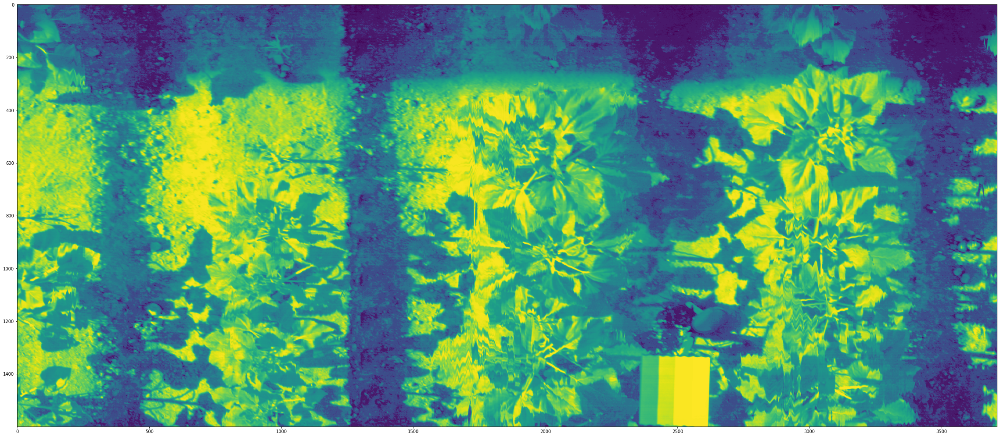

In [16]:
# hist equalization

import cv2
import numpy as np
from matplotlib import pyplot as plt
import glob
import random

images = glob.glob('./selected_train_images/*.png')


# img = cv2.imread('/home/travis_s/repos/infloresence_detection/selected_train_images/c75c2548-7ded-4799-bab0-bfb697bad4ff.png', 1)

img = cv2.imread(random.choice(images))

src = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
img = cv2.equalizeHist(src)





plt.figure(figsize = (40,40))
plt.imshow(img)
plt.show()

In [20]:
# hist equalization training


import cv2
import numpy as np
from matplotlib import pyplot as plt
import glob
import random
import os
import shutil

images = glob.glob('./selected_train_images/*')


# img = cv2.imread('/home/travis_s/repos/infloresence_detection/selected_train_images/c75c2548-7ded-4799-bab0-bfb697bad4ff.png', 1)
for img_file in images:
    name = os.path.basename(img_file)

    if name.endswith('.png'):

        img = cv2.imread(img_file)

        src = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
        img = cv2.equalizeHist(src)

        

        cv2.imwrite('./hist_equal_selected_train_images/' + name, img)

    else:
        shutil.copy(img_file, './hist_equal_selected_train_images/')


In [ ]:
# Training

In [21]:
import os
import numpy as np
import shutil
import random
import os 
import glob 
import json
from shutil import copyfile
import cv2


# We were just pulling out the png's but we need the ones that also have xml's
png_list = glob.glob('./hist_equal_selected_train_images/*.png')

xml_list = glob.glob('./hist_equal_selected_train_images/*.xml')

xml_basename_list = [i.replace('.xml','') for i in xml_list]
png_basename_list = [i.replace('.png', '') for i in png_list]
common_list = list(set(xml_basename_list).intersection(png_basename_list))
final_list = [i+'.png' for i in common_list]


# # Creating Train / Val / Test folders (One time use)
#root_dir = '/xdisk/ericlyons/big_data/egonzalez/flir_lid_detection'
root_dir = './hist_final_set/'

val_ratio = 0.10
test_ratio = 0.10


os.makedirs(root_dir +'/train')
os.makedirs(root_dir +'/val')
os.makedirs(root_dir +'/test')

allFileNames = np.array(final_list)
np.random.shuffle(allFileNames)
train_FileNames, val_FileNames, test_FileNames = np.split(np.array(allFileNames),
                                                          [int(len(allFileNames)* (1 - (val_ratio + test_ratio))), 
                                                           int(len(allFileNames)* (1 - test_ratio))])

print(len(train_FileNames), len(val_FileNames), len(test_FileNames))
train_FileNames = [name for name in train_FileNames.tolist()]
val_FileNames = [name for name in val_FileNames.tolist()]
test_FileNames = [name for name in test_FileNames.tolist()]

print('Total images: ', len(allFileNames))
print('Training: ', len(train_FileNames))
print('Validation: ', len(val_FileNames))
print('Testing: ', len(test_FileNames))

    

# Copy-pasting images

for name in train_FileNames:
    # print(name)
    try:
        xml = name.replace('.png', '.xml')
        shutil.copy(name, root_dir +'/train')
        print('yes')
        shutil.copy(xml, root_dir +'/train')
        print('no')
    except:
        pass

for name in val_FileNames:
    try:
        xml = name.replace('.png', '.xml')
        shutil.copy(name, root_dir +'/val')
        shutil.copy(xml, root_dir +'/val')
    except:
        pass
    
for name in test_FileNames:
    try:
        xml = name.replace('.png', '.xml')
        shutil.copy(name, root_dir +'/test')
        shutil.copy(xml, root_dir +'/test')
    except:
        pass
    


32 4 5
Total images:  41
Training:  32
Validation:  4
Testing:  5
yes
no
yes
no
yes
no
yes
no
yes
no
yes
no
yes
no
yes
no
yes
no
yes
no
yes
no
yes
no
yes
no
yes
no
yes
no
yes
no
yes
no
yes
no
yes
no
yes
no
yes
no
yes
no
yes
no
yes
no
yes
no
yes
no
yes
no
yes
no
yes
no
yes
no
yes
no
yes
no


/home/travis_s/.local/lib/python3.8/site-packages/torch/cuda/__init__.py:52: UserWarning: CUDA initialization: Found no NVIDIA driver on your system. Please check that you have an NVIDIA GPU and installed a driver from http://www.nvidia.com/Download/index.aspx (Triggered internally at  /pytorch/c10/cuda/CUDAFunctions.cpp:100.)
  return torch._C._cuda_getDeviceCount() > 0
  0%|          | 0/32 [00:00<?, ?it/s]It looks like you're training your model on a CPU. Consider switching to a GPU; otherwise, this method can take hours upon hours or even days to finish. For more information, see https://detecto.readthedocs.io/en/latest/usage/quickstart.html#technical-requirements
Epoch 1 of 8
Begin iterating over training dataset
  0%|          | 0/32 [00:00<?, ?it/s]Loss: 1.383182168006897
Epoch 2 of 8
Begin iterating over training dataset
  0%|          | 0/32 [00:00<?, ?it/s]Loss: 1.2859527170658112
Epoch 3 of 8
Begin iterating over training dataset
  0%|          | 0/32 [00:00<?, ?it/s]Loss: 1

Text(0, 0.5, 'Loss')

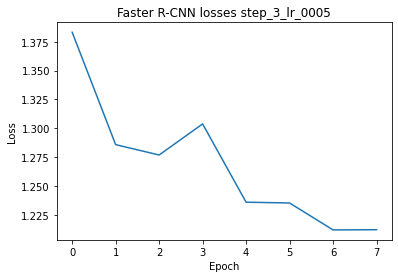

In [1]:
from detecto import core, utils, visualize
import os
import random 
import glob
import matplotlib.pyplot as plt
import cv2
from xml.dom import minidom#, parse
import numpy

from torchvision import transforms
from detecto.utils import normalize_transform

os.chdir('./hist_final_set/')

dataset = core.Dataset('./train/')

loader = core.DataLoader(dataset, batch_size=1, shuffle=True)

val_dataset = core.Dataset('./val/')
model = core.Model(['flower'])

#losses = model.fit(loader, val_dataset, epochs=10, learning_rate=0.001, verbose=True)
losses = model.fit(loader, val_dataset, epochs=12, learning_rate=0.0001, verbose=True, lr_step_size=3)


plt.plot(losses)
plt.title('Faster R-CNN losses step_3_lr_0005')
plt.xlabel('Epoch')
plt.ylabel('Loss')

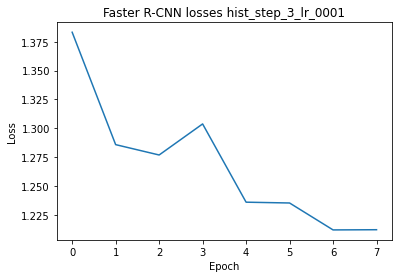

In [6]:
plt.plot(losses)
plt.title('Faster R-CNN losses hist_step_3_lr_0001')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.savefig('model_weights_infloresence_2021-07-15_8epoc_hist_w_step_3_lr_0001.png', dpi=300, transparent=False, facecolor='w', edgecolor='w')

In [3]:
model.save('./model_weights_infloresence_2021-07-15_8epoc_hist_w_step_3_lr_0001.pth')

['flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower']

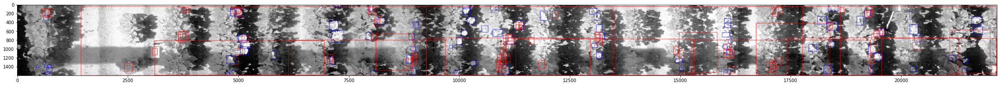

['flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower']

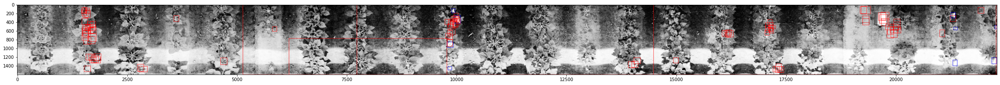

['flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower']

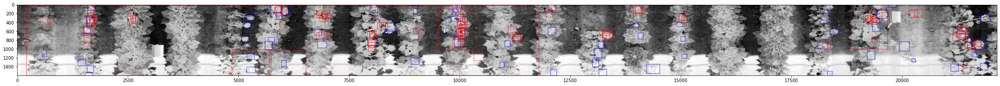

['flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower']

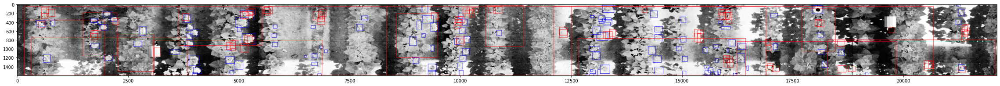

['flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower', 'flower']

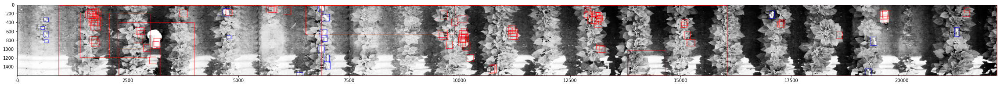

In [7]:
import xml.etree.ElementTree as ET

detect_dict = {}

for img in glob.glob('./test/*.png'):
    cnt = 0
    image = utils.read_image(img)
    predictions = model.predict(image)

    # predictions format: (labels, boxes, scores)
    labels, boxes, scores = predictions
    print(labels, scores)
    a_img = cv2.imread(img)
    a_img = cv2.cvtColor(a_img, cv2.COLOR_BGR2RGB)
    copy = a_img.copy()

    xml = img.replace('.png', '.xml')
    mydoc = minidom.parse(xml)
    items = mydoc.getElementsByTagName('object')
    tree = ET.parse(xml)
    root = tree.getroot()

    list_with_all_boxes = []

    for roi in root.iter('object'):
        file_name = root.find('filename').text
        ymin, xmin, ymax, xmax = None, None, None, None 

        ymin = int(roi.find("bndbox/ymin").text)
        xmin = int(roi.find("bndbox/xmin").text)
        ymax = int(roi.find("bndbox/ymax").text)
        xmax = int(roi.find("bndbox/xmax").text)
        gt = [ymin, xmin, ymax, xmax]

        start_point = (xmin, ymax)
        end_point = (xmax, ymin)
        color = (0, 0, 255) 
        thickness = 6
        cv2.rectangle(a_img, start_point, end_point, color, thickness)

    for i, box in enumerate(boxes):

        if scores[i] >= 0.1:
            cnt += 1
            min_x, min_y, max_x, max_y = int(box[0]), int(box[1]), int(box[2]), int(box[3])
            ml = [min_y, min_x, max_y, max_x]

            start_point = (min_x, max_y)
            end_point = (max_x, min_y)
            color = (255, 0, 0) 
            thickness = 6

            new_img = copy[min_y:max_y, min_x:max_x, :]
            cv2.rectangle(a_img, start_point, end_point, color, thickness)

    plt.figure(figsize=(40, 20))
    plt.imshow(a_img) 
    plt.show()  # display it